# Education and Career Success

*Replace this text with your summary, including research questions as a numbered list and answers for each research questions.*

The following project seeks to utilize a [dataset](https://www.kaggle.com/datasets/adilshamim8/education-and-career-success) from Kaggle to conduct a data science inquiry on how education and career success may be aligned or related. We are personally vested in this project due to our graduating statuses nearing, which guides us to learning what the most important aspects of a good candidate for a successful career would be. Our personal stakes in this project ensure a devotion to getting accurate and clear answers to our questions, which then allows us to draw meaningful conclusions at the end of this project. Knowing the answers to our questions will help us understand how the job world works, what the profiles of successful people look like, and what thriving in a career post-education would look like.

## Research Questions
1. Are there patterns in certain fields of study in regard to gender? Is it fair to say that specific genders tend to lean towards a specific career path?
2. How do the fields of study affect career success and is it more important than other factors such as internships, projects, or networking?
3. Is it possible to predict career success for a student based on certain factors in their college education?
4. Is there an ideal machine learning algorithm to accurately model/predict certain patterns or results based on the entries found in the dataset? If so, what is the algorithm and why is it the best?

## Challenge Goals

We will work towards two challenge goals throughout the duration of this project:
1. __Advanced Machine Learning:__ Use 3 different ML algorithms in scikit-learn with hyperparameter tuning
2. __New Library:__ Use `altair` to create interactive data visualizations


## Collaboration and Conduct

Students are expected to follow Washington state law on the [Student Conduct Code for the University of Washington](https://www.washington.edu/admin/rules/policies/WAC/478-121TOC.html). In this course, students must:

- Indicate on your submission any assistance received, including materials distributed in this course.
- Not receive, generate, or otherwise acquire any substantial portion or walkthrough to an assessment.
- Not aid, assist, attempt, or tolerate prohibited academic conduct in others.

Update the following code cell to include your name and list your sources. If you used any kind of computer technology to help prepare your assessment submission, include the queries and/or prompts. Submitted work that is not consistent with sources may be subject to the student conduct process.

In [ ]:
your_name = "Alan Lin, Altti Koskinen"
sources = [
    "Education Assessment Notebook", "Mapping Assessment Notebook",
    "Google search query: 'seaborn documentation'", "https://seaborn.pydata.org/generated/seaborn.catplot.html",
    "Google search query: 'seaborn wide form data'", "https://seaborn.pydata.org/tutorial/data_structure.html",
    "Google search query: 'altair documentation'", "https://altair-viz.github.io",
    "https://altair-viz.github.io/gallery/bar_chart_sorted.html", "Primer Assessment Notebook",
    "Google search query: 'python series remove column'", "https://pandas.pydata.org/docs/reference/api/pandas.Series.drop.html",
    "Google search query: 'Change values of string to numbers in DataFrame'", "https://saturncloud.io/blog/how-to-replace-strings-with-numbers-in-python-pandas-dataframe/"
]

assert your_name != "", "your_name cannot be empty"
assert ... not in sources, "sources should not include the placeholder ellipsis"
assert len(sources) >= 6, "must include at least 6 sources, inclusive of lectures and sections"

## Data Setting and Methods

We begin by importing our necessary dependencies for this project, including the interactive visualization library `altair`.

In [72]:
import doctest

import altair as alt
from altair import datum

import pandas as pd
import numpy as np

from matplotlib.collections import PatchCollection
from matplotlib.axes import Axes
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

We then import the dataset as a Pandas DataFrame and set `Student_ID` as the index column since it is a unique identifier for each student within the DataFrame.

In [68]:
data = pd.read_csv("education_career_success.csv", na_values=["---"]).set_index("Student_ID")
data

,Age,Gender,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Field_of_Study,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,Job_Offers,Starting_Salary,Career_Satisfaction,Years_to_Promotion,Current_Job_Level,Work_Life_Balance,Entrepreneurship
Student_ID,,,,,,,,,,,,,,,,,,,
S00001,24,Male,3.58,1052,291,3.96,Arts,3,7,2,9,8,5,27200.0,4,5,Entry,7,No
S00002,21,Other,2.52,1211,112,3.63,Law,4,7,3,8,1,4,25000.0,1,1,Mid,7,No
S00003,28,Female,3.42,1193,715,2.63,Medicine,4,8,1,1,9,0,42400.0,9,3,Entry,7,No
S00004,25,Male,2.43,1497,170,2.81,Computer Science,3,9,1,10,6,1,57400.0,7,5,Mid,5,No
S00005,22,Male,2.08,1012,599,2.48,Engineering,4,6,4,10,9,4,47600.0,9,5,Entry,2,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S04996,26,Female,2.44,1258,776,2.44,Arts,3,7,3,8,5,5,31500.0,9,5,Mid,7,No
S04997,18,Female,3.94,1032,923,3.73,Law,0,9,3,6,4,5,41800.0,9,2,Entry,4,No
S04998,19,Female,3.45,1299,720,2.52,Law,3,5,5,6,2,2,49500.0,2,5,Mid,6,No


We create a subset of the DataFrame by making a duplicate of the first ten entries in `data` and assigning that to our variable `mini`, which will function as our testing dataset for this project.

In [5]:
mini = data.head(10)
mini

,Age,Gender,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Field_of_Study,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,Job_Offers,Starting_Salary,Career_Satisfaction,Years_to_Promotion,Current_Job_Level,Work_Life_Balance,Entrepreneurship
Student_ID,,,,,,,,,,,,,,,,,,,
S00001,24,Male,3.58,1052,291,3.96,Arts,3,7,2,9,8,5,27200.0,4,5,Entry,7,No
S00002,21,Other,2.52,1211,112,3.63,Law,4,7,3,8,1,4,25000.0,1,1,Mid,7,No
S00003,28,Female,3.42,1193,715,2.63,Medicine,4,8,1,1,9,0,42400.0,9,3,Entry,7,No
S00004,25,Male,2.43,1497,170,2.81,Computer Science,3,9,1,10,6,1,57400.0,7,5,Mid,5,No
S00005,22,Male,2.08,1012,599,2.48,Engineering,4,6,4,10,9,4,47600.0,9,5,Entry,2,No
S00006,24,Male,2.40,1600,631,3.78,Law,2,3,2,2,2,1,68400.0,9,2,Entry,8,Yes
S00007,27,Male,2.36,1011,610,3.83,Computer Science,0,1,3,3,3,2,55500.0,7,4,Mid,3,No
S00008,20,Male,2.68,1074,240,2.84,Computer Science,1,5,5,5,1,2,38000.0,2,3,Entry,3,No
S00009,24,Male,2.84,1201,337,3.31,Business,2,3,0,5,5,2,68900.0,2,2,Entry,2,No


We now check if there exist any Null values in the dataset, as well as the number of unique values for each column in the DataFrame.

In [6]:
na_counts = data.isna().sum()
print(na_counts)

Age                      0
Gender                   0
High_School_GPA          0
SAT_Score                0
University_Ranking       0
University_GPA           0
Field_of_Study           0
Internships_Completed    0
Projects_Completed       0
Certifications           0
Soft_Skills_Score        0
Networking_Score         0
Job_Offers               0
Starting_Salary          0
Career_Satisfaction      0
Years_to_Promotion       0
Current_Job_Level        0
Work_Life_Balance        0
Entrepreneurship         0
dtype: int64


In [7]:
unique_vals = data.nunique()
print(unique_vals)

Age                       12
Gender                     3
High_School_GPA          201
SAT_Score                700
University_Ranking       993
University_GPA           201
Field_of_Study             7
Internships_Completed      5
Projects_Completed        10
Certifications             6
Soft_Skills_Score         10
Networking_Score          10
Job_Offers                 6
Starting_Salary          623
Career_Satisfaction       10
Years_to_Promotion         5
Current_Job_Level          4
Work_Life_Balance         10
Entrepreneurship           2
dtype: int64


We see that the dataset contains no Null values, and there are many different values that exist in certain columns (like `University_Ranking` and `Starting_Salary`), some columns use integer values between 1-10 to quantify values (such as `Career_Satisfation` and `Soft_Skills_Score`), while others simply have binary or a handful of values to choose from (such as `Gender` and `Entrepreneurship`). This distribution of the DataFrame will inform our choices as we move forward in this project.

## Results

*Replace this text with your results. This section tends to be one of the longer sections of the notebook. Be sure to create new code cells and new Markdown text cells with additional subheadings to explain and break-up longer snippets of code into a more readable format.*

1. *Present and discuss your research results. Treat each of your research questions separately. Include additional discussions for results that are most interesting, surprising, or important.*
2. *Interpret the results. If the answers are unexpected, try to offer an explanation. A good report not only presents the results, but also provides an argument or interpretation based on the data analysis.*
3. *Include any visualizations you have made. In general, these should be generated by your Python code. If you plotted by hand or other software, explain why it was not possible to create the plot you wanted in Python and what you tried.*

*As with assessments, documentation and testing are required. Automated tests must be written in Python using small, manually-verifiable data.*

### EDA with `altair`
Our following steps will involve some exploratory data analysis, where we will utilize the `altair` library in order to create interactive visualizations that may show some relationships between certain columns in the dataset while also meeting our second challenge goal. Each of the subsequently generated plots will be labeled for ease of readability.

The first visualization we create will help us answer our first research question by allowing the user to filter the dataset by gender and analyze the distribution in field of study for students of these various genders.

In [8]:
input_dropdown = alt.binding_select(options=['Male', 'Female', 'Other'], name='Gender: ')
selection = alt.selection_point(fields=['Gender'], bind=input_dropdown, value = "Male")
title = "Number of Students Studying Each Field for Selected Gender"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Number of Students"),
    alt.Color(field = "Entrepreneurship"),
    tooltip = [alt.Tooltip(field = "Gender", title = "Gender:"),
               alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
               alt.Tooltip(aggregate = "count", title = "Count:"),
               alt.Tooltip(field = "Entrepreneurship", title = "Entrepreneurship:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

The visualization above allows us to form an answer to the first research question. We see that the data seems to be similar to a uniform distribution for all genders, and there is no significant inclination to a specific field regardless of gender. On top of that, entrepreneurship seems to be uniformly distributed across the various fields of study as well for all genders in this dataset, which suggests that gender and field of study do not have a significant (if even noticeable) effect on students choosing to start a personal business upon graduation. An interesting thing to note is that Computer Science was the least-pursued field of study for males and females in this dataset, but the most popular field of study for students in this dataset who identified their gender as other. Another interesting conclusion from this visualization is that the most pursued field of study for males were the arts, whereas the most pursued field of study for females was Law. Overall, this interactive visualization provides a significant amount of information regarding the distribution of fields of study based on gender and entrepreneurship, but doesn't allow us to find any conclusive perspectives with regards to patterns in this dataset with the corresponding columns.

We next look to map the performances of students in high school and university settings by creating a scatter plot that sets their GPAs in both educational levels. We also created a scatter plot that maps the quantitative measurables for a high school student (their GPA and SAT score), which are keystone indicators of student performance in university admission deisions. 

In [9]:
title = "University vs High School GPA"
alt.Chart(data, title = title, width = 500, height = 500).mark_circle().encode(
    alt.X("High_School_GPA").title("High School GPA"), 
    alt.Y("University_GPA").title("University GPA"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "High_School_GPA", title = "High School GPA:"),
             alt.Tooltip(field = "University_GPA", title = "University GPA:")]
    ).interactive()

alt.Chart(...)

In [10]:
title = "SAT Score vs High School GPA"
alt.Chart(data, title = title, width = 500, height = 500).mark_circle().encode(
    alt.X("High_School_GPA").title("High School GPA"), 
    alt.Y("SAT_Score").title("SAT Score"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "High_School_GPA", title = "High School GPA:"),
               alt.Tooltip(field = "SAT_Score", title = "SAT Score:")]
    ).interactive()

alt.Chart(...)

We then pivot to answering the second of our research questions. We note that the second question asks us to compare the relationship between fields of study for students and career success with other factors such as internships, projects, and networking. To solve this, we first need to create a definition for "career success". Among the 20 columns in the dataset, the best ones for measuring career success are: `Job_Offers`, `Starting_Salary`, `Career_Satisfaction`, `Years_to_Promotion`, `Current_Job_Level`, and `Work_Life_Balance`. As such, we attempt to create a visualization that can accurately capture the effects of fields of study, internships, projects, networking scores, and such on the 6 columns mentioned above. To do so, we can create various interactive visualizations that each capture a column from above and utilize one of the factors we mentioned. 

We start by looking at the effect that field of study has on a student's options out of college.

In [11]:
num_jobs = sorted(list(set(data["Job_Offers"].values)))
print(num_jobs)

[0, 1, 2, 3, 4, 5]


In [12]:
input_dropdown = alt.binding_select(options = num_jobs, name = 'Number of Job Offers Out of University: ')
selection = alt.selection_point(fields=['Job_Offers'], bind=input_dropdown, value = 0)
title = "Selected Number of Job Offers for Various Fields of Study"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Count").scale(domain = [0, 160]),
    tooltip = [alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
                alt.Tooltip(aggregate = "count", title = "Number of Job Offers:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [13]:
majors = sorted(list(set(data["Field_of_Study"].values)))
print(majors)

['Arts', 'Business', 'Computer Science', 'Engineering', 'Law', 'Mathematics', 'Medicine']


In [14]:
input_dropdown = alt.binding_select(options = majors, name = 'Field of Study: ')
selection = alt.selection_point(fields=["Field_of_Study"], bind=input_dropdown)
title = "Histogram of Starting Salary Based on Selected Field of Study"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Starting_Salary:Q", bin = True).title("Starting Salary"),
    alt.Y("count()").title("Count"),
    tooltip = [alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [15]:
promotion_time = sorted(list(set(data["Years_to_Promotion"].values)))
print(promotion_time)

[1, 2, 3, 4, 5]


In [16]:
input_dropdown = alt.binding_select(options = promotion_time, name = 'Years to Job Promotion: ')
selection = alt.selection_point(fields=['Years_to_Promotion'], bind=input_dropdown, value = 1)

title1 = "Count of Selected Years to Promotion Based on University Ranking (Binned)"
chart1 = alt.Chart(data, title = title1, width = 450).mark_bar().encode(
    alt.X("University_Ranking:Q", bin = True).title("University Ranking"),
    alt.Y("count()").title("Count").scale(domain = [0, 180]),
    tooltip = [alt.Tooltip(field = "University_Ranking:Q", title = "University Ranking:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title2 = "Count of Selected Years to Promotion Based on University GPA (Binned)"
chart2 = alt.Chart(data, title = title2, width = 450).mark_bar().encode(
    alt.X("University_GPA:Q", bin = True).title("University GPA"),
    alt.Y("count()").title("Count").scale(domain = [0, 140]),
    tooltip = [alt.Tooltip(field = "University_GPA:Q", title = "University GPA:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title3 = "Count of Selected Years to Promotion Based on Field of Study"
chart3 = alt.Chart(data, title = title3, width = 450).mark_bar().encode(
    alt.X("Field_of_Study").title("Field of Study"),
    alt.Y("count()").title("Count").scale(domain = [0, 180]),
    tooltip = [alt.Tooltip(field = "Field_of_Study", title = "Field of Study:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title4 = "Count of Selected Years to Promotion Based on Number of Internships Completed"
chart4 = alt.Chart(data, title = title4, width = 450).mark_bar().encode(
    alt.X("Internships_Completed:O").title("Internships Completed"),
    alt.Y("count()").title("Number of Internships Completed").scale(domain = [0, 240]),
    tooltip = [alt.Tooltip(field = "Internships_Completed", title = "Internships Completed:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title5 = "Count of Selected Years to Promotion Based on Number of Projects Completed"
chart5 = alt.Chart(data, title = title5, width = 450).mark_bar().encode(
    alt.X("Projects_Completed:O").title("Projects Completed"),
    alt.Y("count()").title("Number of Projects Completed").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Projects_Completed", title = "Projects Completed:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title6 = "Count of Selected Years to Promotion Based on Number of Certifications"
chart6 = alt.Chart(data, title = title6, width = 450).mark_bar().encode(
    alt.X("Certifications:O").title("Certifications"),
    alt.Y("count()").title("Number of Certifications").scale(domain = [0, 200]),
    tooltip = [alt.Tooltip(field = "Certifications", title = "Number of Certifications:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title7 = "Count of Selected Years to Promotion Based on Soft Skills Score"
chart7 = alt.Chart(data, title = title7, width = 450).mark_bar().encode(
    alt.X("Soft_Skills_Score:O").title("Soft Skills Score"),
    alt.Y("count()").title("Count").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Soft_Skills_Score", title = "Soft Skills Score:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

title8 = "Count of Selected Years to Promotion Based on Networking Score"
chart8 = alt.Chart(data, title = title8, width = 450).mark_bar().encode(
    alt.X("Networking_Score:O").title("Networking Score"),
    alt.Y("count()").title("Count").scale(domain = [0, 120]),
    tooltip = [alt.Tooltip(field = "Networking_Score", title = "Networking Score:"),
                alt.Tooltip(aggregate = "count", title = "Number of Entries:")]
    ).add_params(selection).transform_filter(selection)

alt.vconcat(alt.hconcat(chart1, chart2), alt.hconcat(chart3, chart4), alt.hconcat(chart5, chart6), alt.hconcat(chart7, chart8))

alt.VConcatChart(...)

In [17]:
num_internships = sorted(list(set(data["Internships_Completed"].values)))
print(num_internships)

[0, 1, 2, 3, 4]


In [18]:
input_dropdown = alt.binding_select(options = num_internships, name = 'Internships Completed: ')
selection = alt.selection_point(fields=['Internships_Completed'], bind=input_dropdown, value = 0)
title = "Count of Current Job Level with Selected Number of Internships Completed"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Current_Job_Level").sort(["Entry", "Mid", "Senior", "Executive"]).title("Current Job Level"),
    alt.Y("count()").title("Count").scale(domain=[0, 550]),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Current_Job_Level", title = "Current Job Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [19]:
input_dropdown = alt.binding_select(options = majors, name = 'Major: ')
selection = alt.selection_point(fields=['Field_of_Study'], bind=input_dropdown, value = "Arts")
title = "Count of Career Satisfaction with Selected Major"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Career_Satisfaction:O").title("Career Satisfaction"),
    alt.Y("count()").title("Number of Students"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Career_Satisfaction", title = "Career Satisfaction Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

In [20]:
input_dropdown = alt.binding_select(options = majors, name = 'Major: ')
selection = alt.selection_point(fields=['Field_of_Study'], bind=input_dropdown, value = "Arts")
title = "Count of Career Satisfaction with Selected Major"
alt.Chart(data, title = title, width = 500).mark_bar().encode(
    alt.X("Career_Satisfaction:O").title("Career Satisfaction"),
    alt.Y("count()").title("Number of Students"),
    alt.Color("Gender"),
    tooltip = [alt.Tooltip(field = "Career_Satisfaction", title = "Career Satisfaction Level:"),
               alt.Tooltip(field = "Gender", title = "Gender:"),
              alt.Tooltip(aggregate = "count", title = "Count:")]
    ).add_params(selection).transform_filter(selection)

alt.Chart(...)

### CONCLUSIONS FROM DATA VISUALIZATIONS AND TRANSITION TO NEXT PART

HIHIHI

### About the data itself
We want the datatypes contained within our columns, so we run a command to capture that. This will then allow us to do data manipulation as necessary for computational steps like getting means and aggregate values, which are good benchmarks that we can use later on in this project.

In [21]:
col_types = data.dtypes
col_types

Age                        int64
Gender                    object
High_School_GPA          float64
SAT_Score                  int64
University_Ranking         int64
University_GPA           float64
Field_of_Study            object
Internships_Completed      int64
Projects_Completed         int64
Certifications             int64
Soft_Skills_Score          int64
Networking_Score           int64
Job_Offers                 int64
Starting_Salary          float64
Career_Satisfaction        int64
Years_to_Promotion         int64
Current_Job_Level         object
Work_Life_Balance          int64
Entrepreneurship          object
dtype: object

We next write a function that will allow us to take the average of specific columns of interest. To check our work, we can precompute the values of 3 columns from our testing dataset `mini`. We choose to calculate the average of the `Age`, `University_GPA`, `Starting_Salary` columns.

For the `Age` column, we have: $\frac{(24 + 21 + 28 + 25 + 22 + 24 + 27 + 20 + 24 + 28)}{10} = 24.3$ 

For the `University_GPA` column, we have: $\frac{(3.96 + 3.63 + 2.63 + 2.81 + 2.48 + 3.78 + 3.83 + 2.84 + 3.31 + 2.33)}{10} = 3.16$ 

For the `Starting_Salary` column, we have: $\frac{(27200.0 + 25000.0 + 42400.0 + 57400.0 + 47600.0 + 68400.0 + 55500.0 + 38000.0 + 68900.0 + 58900.0)}{10} = 48,930.0$

In [22]:
def avg_col(col, data):
    '''
    avg_col returns the mean value of the column that is passed in. It takes two parameters:
    col is a String with the name of the desired column (case-sensitive), and data (a DataFrame)
    with the information to look from
    >>> avg_col("Age", mini)
    Average of Age is: 24.3
    >>> avg_col("University_GPA", mini)
    Average of University_GPA is: 3.16
    >>> avg_col("Starting_Salary", mini)
    Average of Starting_Salary is: 48930.0
    '''
    print("Average of", col, "is:", data[col].mean())
    
doctest.run_docstring_examples(avg_col, globals())

We want to drops the columns in `data` that have data type `Object` so that we can run our `col_avg()` function on the remaining columns and get the average of each column value.

In [23]:
object_cols = ["Gender", "Field_of_Study", "Current_Job_Level", "Entrepreneurship"]
numerical_col_types = col_types
numerical_cols = data.columns
for col in object_cols:
    numerical_col_types = numerical_col_types.drop(col)
    numerical_cols = numerical_cols.drop(col)
numerical_col_types

Age                        int64
High_School_GPA          float64
SAT_Score                  int64
University_Ranking         int64
University_GPA           float64
Internships_Completed      int64
Projects_Completed         int64
Certifications             int64
Soft_Skills_Score          int64
Networking_Score           int64
Job_Offers                 int64
Starting_Salary          float64
Career_Satisfaction        int64
Years_to_Promotion         int64
Work_Life_Balance          int64
dtype: object

Now that we have the `avg_col()` function written and have dropped the columns that aren't numerical, we can create an "average" student in this dataset by calling the function on the various numerical value columns. This gives us a sense of what a typical student would look like in this dataset.

In [24]:
for col in numerical_cols:
    avg_col(col, data)

Average of Age is: 23.4422
Average of High_School_GPA is: 2.9969780000000004
Average of SAT_Score is: 1253.832
Average of University_Ranking is: 504.3356
Average of University_GPA is: 3.0200280000000004
Average of Internships_Completed is: 1.9822
Average of Projects_Completed is: 4.5628
Average of Certifications is: 2.5122
Average of Soft_Skills_Score is: 5.546
Average of Networking_Score is: 5.538
Average of Job_Offers is: 2.4888
Average of Starting_Salary is: 50563.54
Average of Career_Satisfaction is: 5.578
Average of Years_to_Promotion is: 3.0158
Average of Work_Life_Balance is: 5.4824


### In a similar vein as above
We now create a method called `median_col()` that will return the median value of each numeric column. This allows us to compare our "average" stupid with another student who is in the middle of the pack based on the data presented in this datatset. We will test our method using our `mini` dataset once again, and we use the three columns `High_School_GPA`, `University_Ranking`, and `Internships_Completed` for the doctests in this method.

For the `High_School_GPA` column, the median is the average of the 5th and 6th ordered values: $\frac{(2.52+2.68)}{2} = 2.6$

For the `University_Ranking` column, the median is the average of the 5th and 6th ordered values: $\frac{(291+337)}{2} = 314.0$

For the `Internships_Completed` column, the median is the average of the 5th and 6th ordered values: $\frac{(2+3)}{2} = 2.5$

In [25]:
def median_col(col, data):
    '''
    median_col returns the median value of the column that is passed in. It takes two parameters:
    col is a String with the name of the desired column (case-sensitive), and data is a DataFrame
    with the information to look from
    >>> median_col("High_School_GPA", mini)
    Median of High_School_GPA is: 2.6
    >>> median_col("University_Ranking", mini)
    Median of University_Ranking is: 314.0
    >>> median_col("Internships_Completed", mini)
    Median of Internships_Completed is: 2.5
    '''

    print("Median of", col, "is:", data[col].median())

doctest.run_docstring_examples(median_col, globals())

In [26]:
for col in numerical_cols:
    median_col(col, data)

Median of Age is: 23.0
Median of High_School_GPA is: 2.99
Median of SAT_Score is: 1257.0
Median of University_Ranking is: 501.5
Median of University_GPA is: 3.03
Median of Internships_Completed is: 2.0
Median of Projects_Completed is: 5.0
Median of Certifications is: 3.0
Median of Soft_Skills_Score is: 6.0
Median of Networking_Score is: 6.0
Median of Job_Offers is: 2.0
Median of Starting_Salary is: 50300.0
Median of Career_Satisfaction is: 6.0
Median of Years_to_Promotion is: 3.0
Median of Work_Life_Balance is: 6.0


In [27]:
test_results = doctest.testmod()
print(test_results)
assert test_results.failed == 0, "There are failed doctests."
# assert test_results.attempted >= 25, "Total number of doctests should be at least 25; less than 25 means you did not add two additional test cases per task."

TestResults(failed=0, attempted=6)


Finally, we will combine all education and career data into an overall career and education score from 0-10. This makes it easier to look at how strong an individuals education was compared to how their career is turning out

In [28]:
new_data = data

def calculate_student_score(high_GPA, sat_score, uni_ranking, uni_GPA, internships, projects, ceritifications, soft_skills, networking):
    max_ranking = new_data['University_Ranking'].max()
    max_internships = new_data['Internships_Completed'].max()
    max_projects = new_data['Projects_Completed'].max()
    max_certifs = new_data['Certifications'].max()
    adjusted_sat = (sat_score / 1600) * 10
    adjusted_uni_ranking = (1 - (uni_ranking / max_ranking)) * 10
    adjusted_high_GPA = (high_GPA / 4) * 10
    adjusted_uni_GPA = (uni_GPA / 4) * 10
    adjusted_internships = (internships / max_internships) * 10
    adjusted_projects = (projects / max_projects) * 10
    adjusted_certifs = (ceritifications / max_certifs) * 10
    return (adjusted_high_GPA * 0.1) + (adjusted_sat * 0.1) + (adjusted_uni_ranking * 0.15) + (adjusted_uni_GPA * 0.15) + (adjusted_internships * 0.2) + (adjusted_projects * 0.1) + (adjusted_certifs * 0.05) + (soft_skills * 0.075) + (networking * 0.075)

def calculate_career_score(job_offers, starting_salary, career_satisfaction, years_to_promotion):
    max_offers = new_data['Job_Offers'].max()
    max_salary = new_data['Starting_Salary'].max()
    max_years = new_data['Years_to_Promotion'].max()
    adjusted_offers = (job_offers / max_offers) * 10
    adjusted_salary = (starting_salary / max_salary) * 10
    adjusted_promotion = (1 - (years_to_promotion / max_years)) * 10
    return (0.25 * adjusted_offers) + (0.4 * adjusted_salary) + (0.1 * career_satisfaction) + (0.25 * adjusted_promotion)


new_data['Student_Score'] = new_data.apply(
    lambda row: calculate_student_score(
        row['High_School_GPA'], 
        row['SAT_Score'], 
        row['University_Ranking'], 
        row['University_GPA'], 
        row['Internships_Completed'], 
        row['Projects_Completed'], 
        row['Certifications'], 
        row['Soft_Skills_Score'], 
        row['Networking_Score']
    ), axis=1)

new_data['Career_Score'] = new_data.apply(
    lambda row: calculate_career_score(
        row['Job_Offers'], 
        row['Starting_Salary'], 
        row['Career_Satisfaction'], 
        row['Years_to_Promotion'], 
    ), axis=1)

new_data

,Age,Gender,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Field_of_Study,Internships_Completed,Projects_Completed,Certifications,...,Networking_Score,Job_Offers,Starting_Salary,Career_Satisfaction,Years_to_Promotion,Current_Job_Level,Work_Life_Balance,Entrepreneurship,Student_Score,Career_Score
Student_ID,,,,,,,,,,,,,,,,,,,,,
S00001,24,Male,3.58,1052,291,3.96,Arts,3,7,2,...,8,5,27200.0,4,5,Entry,7,No,7.853778,3.977228
S00002,21,Other,2.52,1211,112,3.63,Law,4,7,3,...,1,4,25000.0,1,1,Mid,7,No,7.832903,5.090099
S00003,28,Female,3.42,1193,715,2.63,Medicine,4,8,1,...,9,0,42400.0,9,3,Entry,7,No,6.753264,3.579208
S00004,25,Male,2.43,1497,170,2.81,Computer Science,3,9,1,...,6,1,57400.0,7,5,Mid,5,No,7.641875,3.473267
S00005,22,Male,2.08,1012,599,2.48,Engineering,4,6,4,...,9,4,47600.0,9,5,Entry,2,No,7.175667,4.785149
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S04996,26,Female,2.44,1258,776,2.44,Arts,3,7,3,...,5,5,31500.0,9,5,Mid,7,No,6.200028,4.647525
S04997,18,Female,3.94,1032,923,3.73,Law,0,9,3,...,4,5,41800.0,9,2,Entry,4,No,5.194250,6.555446
S04998,19,Female,3.45,1299,720,2.52,Law,3,5,5,...,2,2,49500.0,2,5,Mid,6,No,6.194931,3.160396


## Next Steps: Machine Learning
We began this project by mainly utilizing the functionalities of the `altair` library to create many visualizations that could tell some stories about the dataset we are working with. Now that we have a brief overview of our dataset and a grasp of the datatypes contained within the columns, we are ready to move on to the machine learning implementations of our project. Our first step is to try doing single variable linear regression as an exercise by using our intuition to test what we believe would matter with regards to career success.

We also want to distinguish a point here for future reference: our definition of "career success" will come from a multitude of columns in the dataset, specifically: `Job_Offers`, `Starting_Salary`, `Career_Satisfaction`, `Years_to_Promotion`, `Current_Job_Level`, and `Work_Life_Balance`. These six columns will allow us to assess various aspects of success once a student graduates from their university, and we will quantify success itself by using the median values calculated above. That means success will be:

At least 2 `Job_Offers`.

At least 50300.0 `Starting_Salary`.

At least 6.0 `Career_Satisfaction`.

At most 3.0 `Years_to_Promotion`.

At least Mid level `Current_Job_Level`.

At least 6.0 `Work_Life_Balance`.

In [29]:
def run_single_var_linear_regression(col_X, col_y):
    X = data[[col_X]]
    y = data[col_y]
    reg = LinearRegression().fit(X, y)

    print("Model:", " + ".join([f"{reg.intercept_:.2f}"] + [f"{coef:.2f}({X.columns[i]})" for i, coef in enumerate(reg.coef_)]))
    print("Error:", mean_squared_error(y, reg.predict(X)))
    
    plt.scatter(X, y)
    plt.plot(X, reg.predict(X), color = "orange")

Model: 50026.85 + 1.06(University_Ranking)
Error: 209965876.99221936


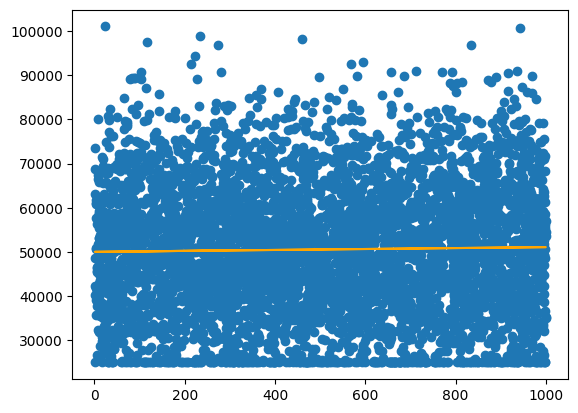

In [30]:
run_single_var_linear_regression("University_Ranking", "Starting_Salary")

Model: 50485.84 + 25.73(University_GPA)
Error: 210061573.0538188


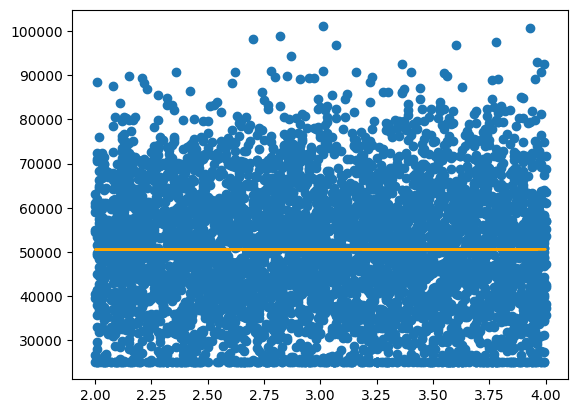

In [31]:
run_single_var_linear_regression("University_GPA", "Starting_Salary")

We note that using singular variables does not quite seem to operate as well as we want, and the graphs themselves suggest that single variable regression is not a useful means of prediction for this dataset. As such, we will venture into multi-variable linear regression to see if that helps us generate a better prediction model. As such, we need to create a copy of our dataset with dummy variables so that categorical variables are transformed into binaries that we can then run machine learning algorithms on.

In [32]:
ml_data = pd.get_dummies(data)
display(ml_data)

,Age,High_School_GPA,SAT_Score,University_Ranking,University_GPA,Internships_Completed,Projects_Completed,Certifications,Soft_Skills_Score,Networking_Score,...,Field_of_Study_Engineering,Field_of_Study_Law,Field_of_Study_Mathematics,Field_of_Study_Medicine,Current_Job_Level_Entry,Current_Job_Level_Executive,Current_Job_Level_Mid,Current_Job_Level_Senior,Entrepreneurship_No,Entrepreneurship_Yes
Student_ID,,,,,,,,,,,,,,,,,,,,,
S00001,24,3.58,1052,291,3.96,3,7,2,9,8,...,False,False,False,False,True,False,False,False,True,False
S00002,21,2.52,1211,112,3.63,4,7,3,8,1,...,False,True,False,False,False,False,True,False,True,False
S00003,28,3.42,1193,715,2.63,4,8,1,1,9,...,False,False,False,True,True,False,False,False,True,False
S00004,25,2.43,1497,170,2.81,3,9,1,10,6,...,False,False,False,False,False,False,True,False,True,False
S00005,22,2.08,1012,599,2.48,4,6,4,10,9,...,True,False,False,False,True,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S04996,26,2.44,1258,776,2.44,3,7,3,8,5,...,False,False,False,False,False,False,True,False,True,False
S04997,18,3.94,1032,923,3.73,0,9,3,6,4,...,False,True,False,False,True,False,False,False,True,False
S04998,19,3.45,1299,720,2.52,3,5,5,6,2,...,False,True,False,False,False,False,True,False,True,False


In [33]:
def run_multi_var_linear_regression(col):
    X = ml_data.drop(col, axis = 1)
    y = ml_data[col]
    reg = LinearRegression().fit(X, y)
    
    print("Model:", " + ".join([f"{reg.intercept_:.2f}"] + [f"{coef:.2f}({X.columns[i]})" for i, coef in enumerate(reg.coef_)]))
    print("Error:", mean_squared_error(y, reg.predict(X)))

Our first experiment with multi-variable linear regression is to use all columns in the dataset except for `Starting_Salary` to predict the value of `Starting_Salary`. We will utilize the method we just wrote above to see what we get.

In [34]:
run_multi_var_linear_regression("Starting_Salary")

Model: -63125.00 + -0.00(Age) + -0.00(High_School_GPA) + -0.00(SAT_Score) + 0.00(University_Ranking) + -0.00(University_GPA) + -0.00(Internships_Completed) + -0.00(Projects_Completed) + -0.00(Certifications) + -0.00(Soft_Skills_Score) + -0.00(Networking_Score) + -12625.00(Job_Offers) + -2525.00(Career_Satisfaction) + 12625.00(Years_to_Promotion) + -0.00(Work_Life_Balance) + 0.00(Student_Score) + 25250.00(Career_Score) + 0.00(Gender_Female) + 0.00(Gender_Male) + 0.00(Gender_Other) + -0.00(Field_of_Study_Arts) + -0.00(Field_of_Study_Business) + -0.00(Field_of_Study_Computer Science) + -0.00(Field_of_Study_Engineering) + -0.00(Field_of_Study_Law) + -0.00(Field_of_Study_Mathematics) + -0.00(Field_of_Study_Medicine) + 0.00(Current_Job_Level_Entry) + 0.00(Current_Job_Level_Executive) + 0.00(Current_Job_Level_Mid) + 0.00(Current_Job_Level_Senior) + 0.00(Entrepreneurship_No) + 0.00(Entrepreneurship_Yes)
Error: 3.2026612197216635e-20


We note that using multiple variables didn't really seem to change the error we have in the prediction model as compared to only using a singular column, which suggests that linear regression is perhaps not super well suited to this dataset. However, we recall the concept of using Recursive Feature Elimination (RFE) as a machine learning model from our lecture on Model Evaluation, so we now pivot to trying RFE on our dataset to see if we can capture the trends of `Starting_Salary` better with lower error and less features.

In [35]:
def model_parameters(reg, columns):
    """Returns a string with the linear regression model parameters for the given column names."""
    slopes = [f"{coef:.2f}({columns[i]})" for i, coef in enumerate(reg.coef_)]
    return " + ".join([f"{reg.intercept_:.2f}"] + slopes)

We want to use an 80/20 split for our train-test dataset splits for linear regression. We begin by running simple linear regression again using this split, then proceed to using RFE to reduce the number of features we consider. We will be able to hit our first challenge goal because the number of features selected by RFE is considered a hyperparameter, which we are choosing to tune in this situation so we can find the $n$ best features to explain variability in `Starting_Salary` for our students. Furthermore, the train-test split itself is another hyperparameter we can tune for various results as well.

In [36]:
X = ml_data.drop("Starting_Salary", axis = 1)
y = ml_data["Starting_Salary"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# During model training, use only the training dataset
reg = LinearRegression().fit(X_train, y_train)

print("Model:", model_parameters(reg, X_train.columns))
print("Error:", root_mean_squared_error(y_test, reg.predict(X_test)))

Model: -63125.00 + 0.00(Age) + -0.00(High_School_GPA) + -0.00(SAT_Score) + 0.00(University_Ranking) + -0.00(University_GPA) + -0.00(Internships_Completed) + -0.00(Projects_Completed) + -0.00(Certifications) + -0.00(Soft_Skills_Score) + -0.00(Networking_Score) + -12625.00(Job_Offers) + -2525.00(Career_Satisfaction) + 12625.00(Years_to_Promotion) + -0.00(Work_Life_Balance) + 0.00(Student_Score) + 25250.00(Career_Score) + 0.00(Gender_Female) + 0.00(Gender_Male) + 0.00(Gender_Other) + -0.00(Field_of_Study_Arts) + -0.00(Field_of_Study_Business) + -0.00(Field_of_Study_Computer Science) + -0.00(Field_of_Study_Engineering) + -0.00(Field_of_Study_Law) + -0.00(Field_of_Study_Mathematics) + -0.00(Field_of_Study_Medicine) + 0.00(Current_Job_Level_Entry) + 0.00(Current_Job_Level_Executive) + 0.00(Current_Job_Level_Mid) + 0.00(Current_Job_Level_Senior) + -0.00(Entrepreneurship_No) + -0.00(Entrepreneurship_Yes)
Error: 6.304020011294669e-11


In [40]:
rfe_implementor(0.5)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Features: ['University_GPA', 'Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Career_Score', 'Gender_Female', 'Gender_Other', 'Field_of_Study_Arts', 'Field_of_Study_Computer Science', 'Field_of_Study_Engineering', 'Field_of_Study_Law', 'Field_of_Study_Mathematics', 'Field_of_Study_Medicine', 'Current_Job_Level_Entry', 'Entrepreneurship_No', 'Entrepreneurship_Yes']
Model: -63125.00 + 0.00(University_GPA) + -126

Some commentary about the above half split

In [41]:
rfe_implementor(0.25)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Features: ['University_GPA', 'Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Career_Score', 'Gender_Other', 'Field_of_Study_L

Some commentary about the above quarter split

In [42]:
rfe_implementor(1)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 feature

Some commentary on "most important feature", conclusions on RFE and transition to next model.

In [43]:
# Let us now use a 70/30 train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

# During model training, use only the training dataset
reg = LinearRegression().fit(X_train, y_train)

print("Model:", model_parameters(reg, X_train.columns))
print("Error:", root_mean_squared_error(y_test, reg.predict(X_test)))

Model: -63125.00 + 0.00(Age) + -0.00(High_School_GPA) + -0.00(SAT_Score) + 0.00(University_Ranking) + -0.00(University_GPA) + -0.00(Internships_Completed) + -0.00(Projects_Completed) + -0.00(Certifications) + -0.00(Soft_Skills_Score) + -0.00(Networking_Score) + -12625.00(Job_Offers) + -2525.00(Career_Satisfaction) + 12625.00(Years_to_Promotion) + 0.00(Work_Life_Balance) + 0.00(Student_Score) + 25250.00(Career_Score) + 0.00(Gender_Female) + 0.00(Gender_Male) + -0.00(Gender_Other) + -0.00(Field_of_Study_Arts) + -0.00(Field_of_Study_Business) + -0.00(Field_of_Study_Computer Science) + -0.00(Field_of_Study_Engineering) + -0.00(Field_of_Study_Law) + -0.00(Field_of_Study_Mathematics) + -0.00(Field_of_Study_Medicine) + 0.00(Current_Job_Level_Entry) + -0.00(Current_Job_Level_Executive) + 0.00(Current_Job_Level_Mid) + -0.00(Current_Job_Level_Senior) + -0.00(Entrepreneurship_No) + 0.00(Entrepreneurship_Yes)
Error: 3.454987534582913e-10


In [38]:
def rfe_implementor(num_features):
    '''
    This method takes one parameter: num_features is an integer or float that will take a fractional
    number of features (if the float passed in is less than 1.0) and the specified number of features
    (if the integer passed in is greater than or equal to 1). The method will then output the results
    of running Recursive Feature Elimination (RFE), including the remaining features, model parameters,
    and error value of the current model.
    '''
    rfe = RFE(LinearRegression(), step=1, n_features_to_select=num_features, verbose=1)
    rfe.fit(X_train, y_train)
    
    # Show the final subset of features
    rfe_features = X.columns[[r == 1 for r in rfe.ranking_]]
    print("Features:", list(rfe_features))
    
    # Extract the last LinearRegression model trained on the final subset of features
    reg = rfe.estimator_
    
    print("Model:", model_parameters(reg, rfe_features))
    print("Error:", root_mean_squared_error(y_test, rfe.predict(X_test)))

In [44]:
rfe_implementor(0.5)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Features: ['Internships_Completed', 'Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Student_Score', 'Career_Score', 'Gender_Female', 'Gender_Male', 'Field_of_Study_Arts', 'Field_of_Study_Business', 'Field_of_Study_Mathematics', 'Field_of_Study_Medicine', 'Current_Job_Level_Entry', 'Current_Job_Level_Mid', 'Current_Job_Level_Senior', 'Entrepreneurship_Yes']
Model: -63125.00 + -0.00(Internships_Completed) + -12

In [45]:
rfe_implementor(0.25)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Features: ['Internships_Completed', 'Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Career_Score', 'Field_of_Study_Arts', 'Cu

In [46]:
rfe_implementor(1)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 feature

In [47]:
# Let us now use a 60/40 train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4)

# During model training, use only the training dataset
reg = LinearRegression().fit(X_train, y_train)

print("Model:", model_parameters(reg, X_train.columns))
print("Error:", root_mean_squared_error(y_test, reg.predict(X_test)))

Model: -63125.00 + 0.00(Age) + -0.00(High_School_GPA) + -0.00(SAT_Score) + 0.00(University_Ranking) + -0.00(University_GPA) + -0.00(Internships_Completed) + -0.00(Projects_Completed) + -0.00(Certifications) + -0.00(Soft_Skills_Score) + -0.00(Networking_Score) + -12625.00(Job_Offers) + -2525.00(Career_Satisfaction) + 12625.00(Years_to_Promotion) + -0.00(Work_Life_Balance) + 0.00(Student_Score) + 25250.00(Career_Score) + 0.00(Gender_Female) + 0.00(Gender_Male) + 0.00(Gender_Other) + 0.00(Field_of_Study_Arts) + 0.00(Field_of_Study_Business) + 0.00(Field_of_Study_Computer Science) + 0.00(Field_of_Study_Engineering) + 0.00(Field_of_Study_Law) + 0.00(Field_of_Study_Mathematics) + 0.00(Field_of_Study_Medicine) + -0.00(Current_Job_Level_Entry) + -0.00(Current_Job_Level_Executive) + 0.00(Current_Job_Level_Mid) + -0.00(Current_Job_Level_Senior) + 0.00(Entrepreneurship_No) + 0.00(Entrepreneurship_Yes)
Error: 6.405653249073543e-11


In [48]:
rfe_implementor(0.5)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Features: ['University_GPA', 'Internships_Completed', 'Networking_Score', 'Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Career_Score', 'Gender_Female', 'Gender_Male', 'Field_of_Study_Business', 'Field_of_Study_Engineering', 'Field_of_Study_Law', 'Field_of_Study_Medicine', 'Current_Job_Level_Executive', 'Current_Job_Level_Mid', 'Current_Job_Level_Senior']
Model: -63125.00 + -0.00(University_GPA) + 0.00(Inter

In [49]:
rfe_implementor(0.25)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Features: ['Job_Offers', 'Career_Satisfaction', 'Years_to_Promotion', 'Career_Score', 'Gender_Female', 'Gender_Male', 'Field_of_Study_Med

In [50]:
rfe_implementor(1)

Fitting estimator with 32 features.
Fitting estimator with 31 features.
Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 feature

We can now move on to using decision trees to do the bulk of our heavy-lifting work with machine learning models for this dataset, as most of the fields that quantify career success are reliant on integer values (such as `Years_to_Promotion` and etc). We note that with decision trees, the number of levels we want can be tuned as a hyperparameter, which helps us hit all of the conditions necessary to meet our first challenge goal.

In [51]:
def dec_tree(col, classes, depth):  
    '''
    This method takes two inputs: col is a String with the name of the column we want to classify,
    and depth is an integer that controls the number of levels we want in our Decision Tree. The
    method will output a decision tree plot that shows how data points will be classified.
    '''
    X = ml_data.drop(col, axis=1)
    y = ml_data[col]
    clf = DecisionTreeClassifier(max_depth=depth).fit(X, y)
    
    import matplotlib.pyplot as plt
    plt.figure(dpi=300)
    plot_tree(
        clf,
        feature_names=X.columns,
        class_names = classes,
        label="root",
        filled=True,
        impurity=False,
        proportion=True,
        rounded=False
    )

### NOTE TO SELF: CONTINUE RUNNING ABOVE ALGORITHMS IN ORDER TO ANSWER RESEARCH QUESTIONS (OR PRESENT ANSWERS FOR THEM AS WELL).

For decision trees: max depth can be tuned as a hyperparameter

For RFE: number of features selected is a hyperparameter 

For linear regression: train-test split can be used as a hyperparameter

For cross validation: size of folds can be tuned as a PARAMETER (may be hyperparameter but please ask).

In [52]:
cross_val_score(
    estimator=DecisionTreeRegressor(max_depth=2),
    X=X_train,
    y=y_train,
    scoring="neg_root_mean_squared_error",
    verbose=3,
)

[CV] END ........................... score: (test=-13681.247) total time=   0.0s
[CV] END ........................... score: (test=-13347.382) total time=   0.0s
[CV] END ........................... score: (test=-13149.823) total time=   0.0s
[CV] END ........................... score: (test=-13096.084) total time=   0.0s
[CV] END ........................... score: (test=-13617.724) total time=   0.0s


array([-13681.24677412, -13347.3818981 , -13149.82277252, -13096.08384105,
       -13617.72376143])

In [53]:
search = GridSearchCV(
    estimator=DecisionTreeRegressor(),
    param_grid={"max_depth": [2, 3, 4, 5, 6, 7, 8, 9, 10]},
    scoring="neg_root_mean_squared_error",
    verbose=3,
)
search.fit(X_train, y_train)

# Show the best score and best estimator at the end of hyperparameter search
print("Mean score for best model:", search.best_score_)
reg = search.best_estimator_
print("Best model:", reg)

Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV 1/5] END ..................max_depth=2;, score=-13681.247 total time=   0.0s
[CV 2/5] END ..................max_depth=2;, score=-13347.382 total time=   0.0s
[CV 3/5] END ..................max_depth=2;, score=-13149.823 total time=   0.0s
[CV 4/5] END ..................max_depth=2;, score=-13096.084 total time=   0.0s
[CV 5/5] END ..................max_depth=2;, score=-13617.724 total time=   0.0s
[CV 1/5] END ..................max_depth=3;, score=-12903.843 total time=   0.0s
[CV 2/5] END ..................max_depth=3;, score=-12978.358 total time=   0.0s
[CV 3/5] END ..................max_depth=3;, score=-12528.794 total time=   0.0s
[CV 4/5] END ..................max_depth=3;, score=-12751.287 total time=   0.0s
[CV 5/5] END ..................max_depth=3;, score=-12851.437 total time=   0.0s
[CV 1/5] END ..................max_depth=4;, score=-12555.534 total time=   0.0s
[CV 2/5] END ..................max_depth=4;, scor

In [54]:
print("Error:", root_mean_squared_error(y_test, reg.predict(X_test)))

Error: 7286.415016585592


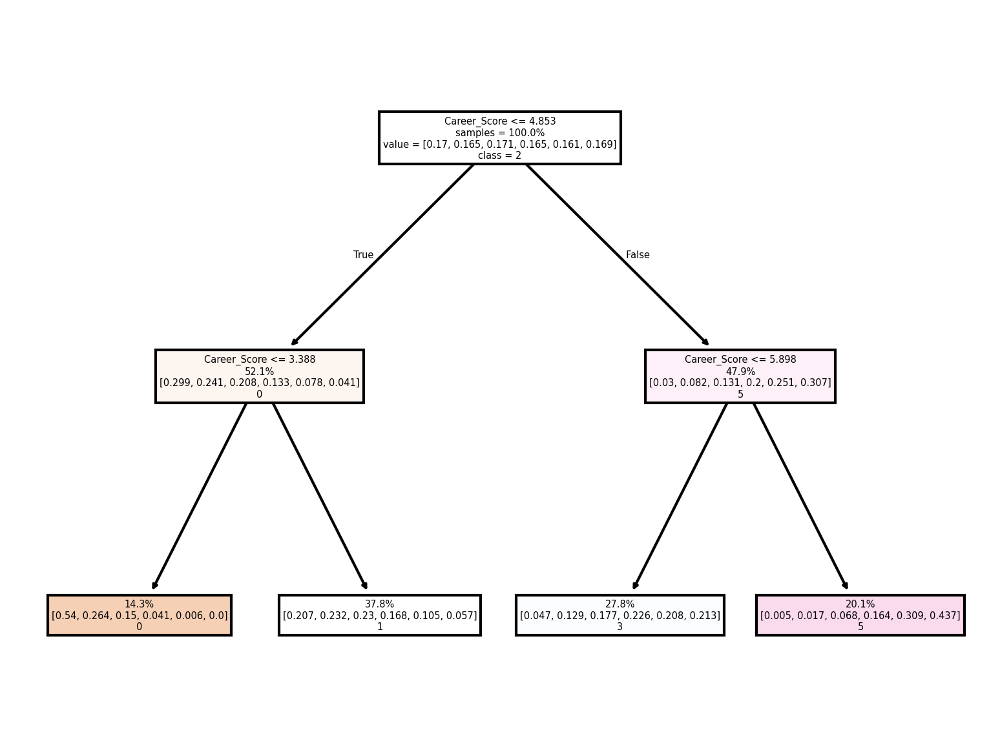

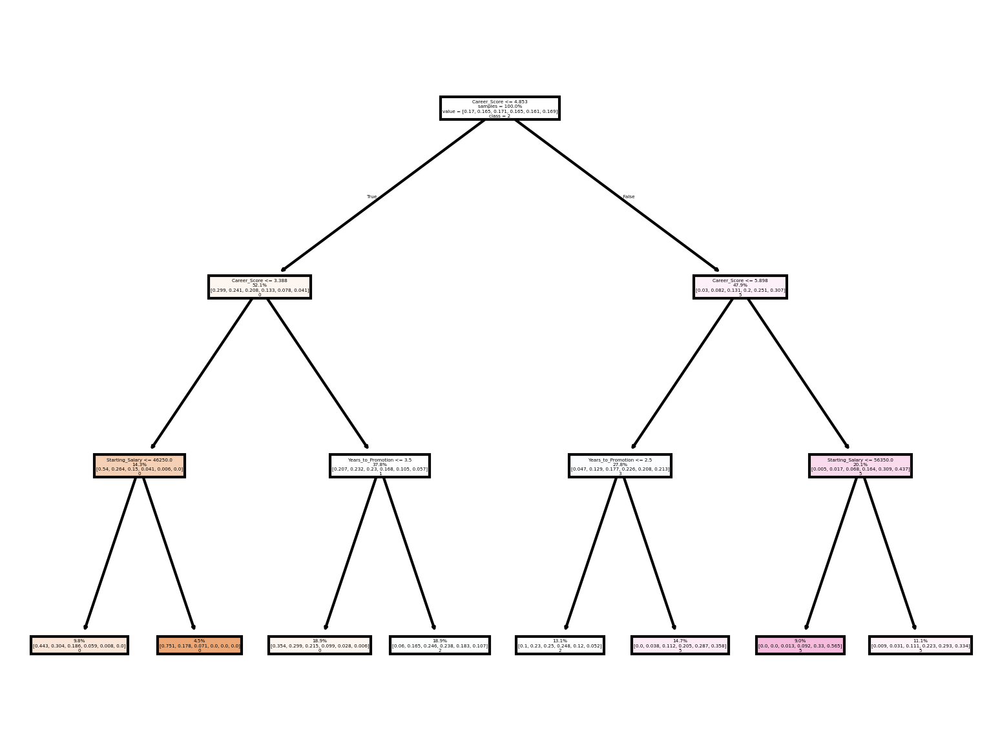

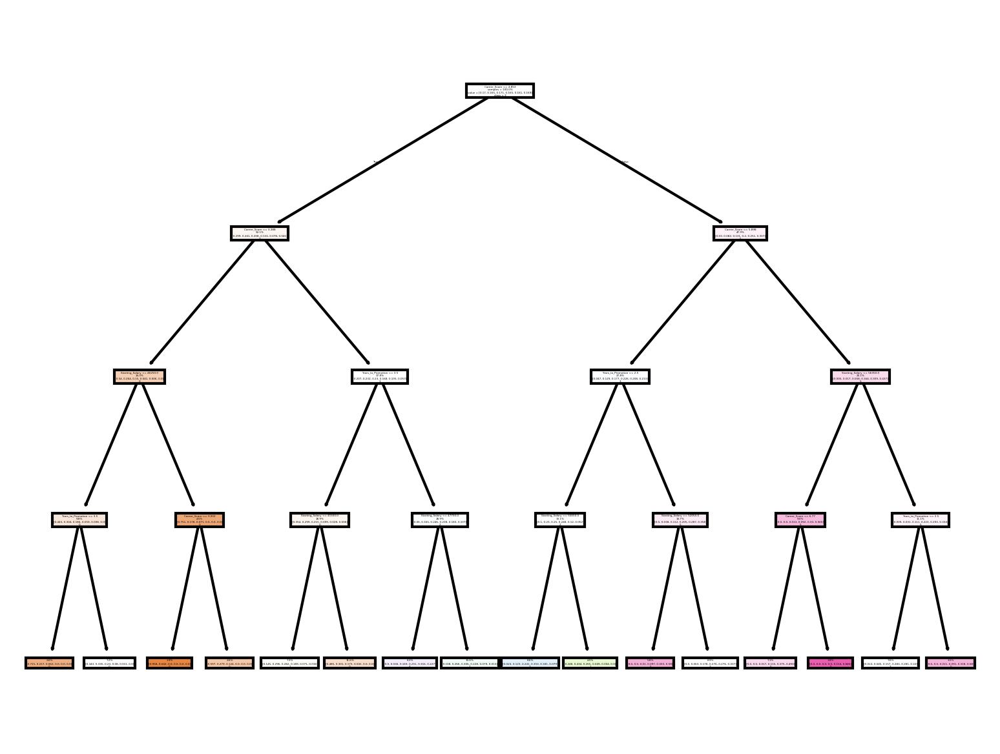

In [55]:
job_offer_vals = ["0", "1", "2", "3", "4", "5"]
for i in [2, 3, 4]:
    dec_tree("Job_Offers", job_offer_vals, i)

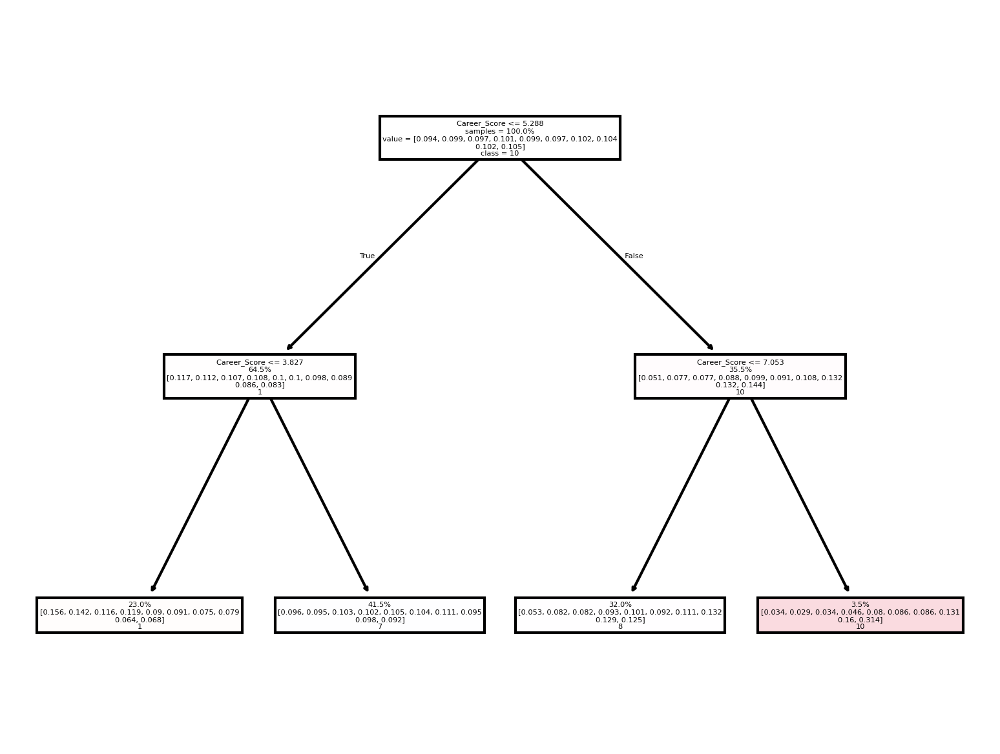

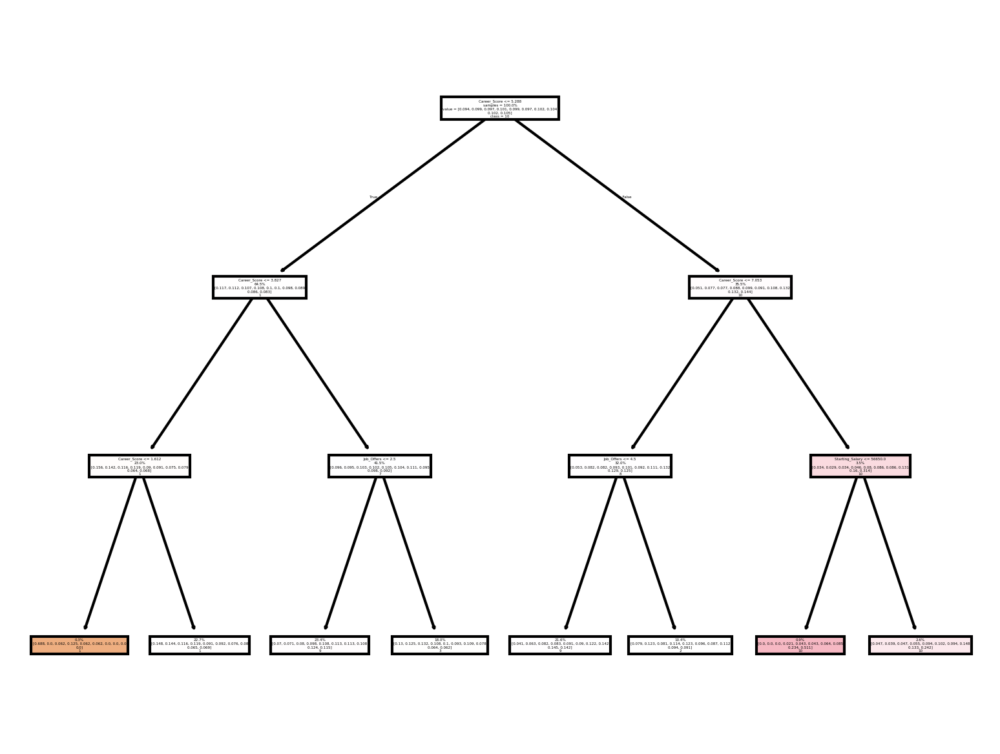

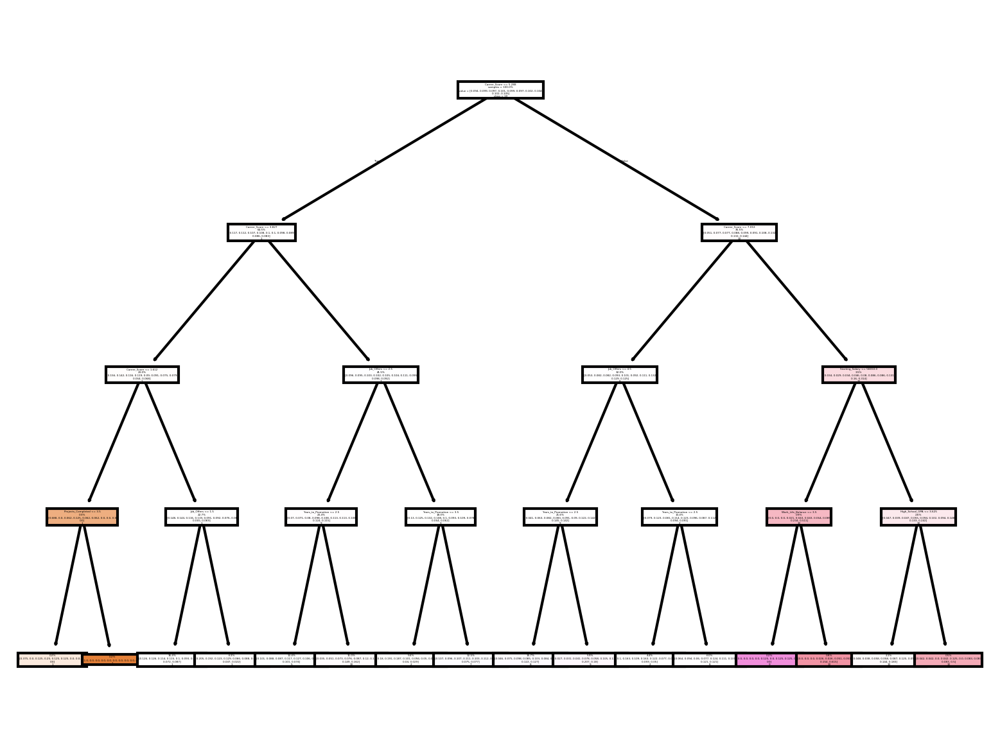

In [56]:
career_satisfaction_vals = ["1", '2', '3', '4', '5', '6', '7', '8', '9', '10']
for i in [2, 3, 4]:
    dec_tree("Career_Satisfaction", career_satisfaction_vals, i)

For job level, we cannot use the ml_data DataFrame since it seperates the Entry ... Executive into 4 seperate columns. Instead we need to assign numbers 1-4 for Entry-Executive strings respectively.

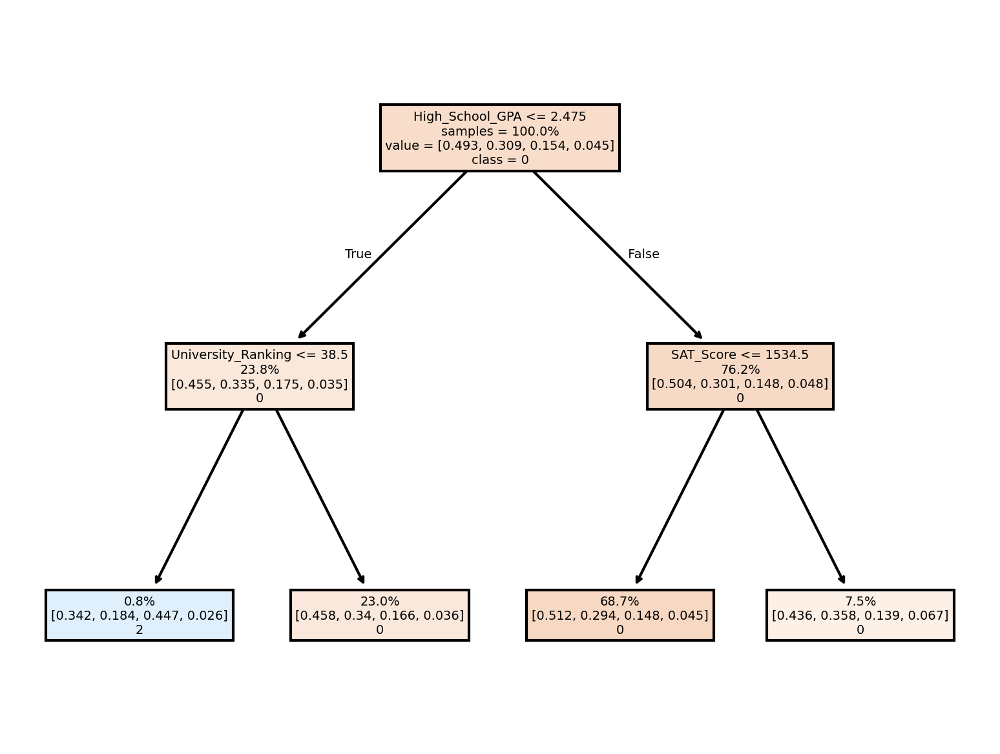

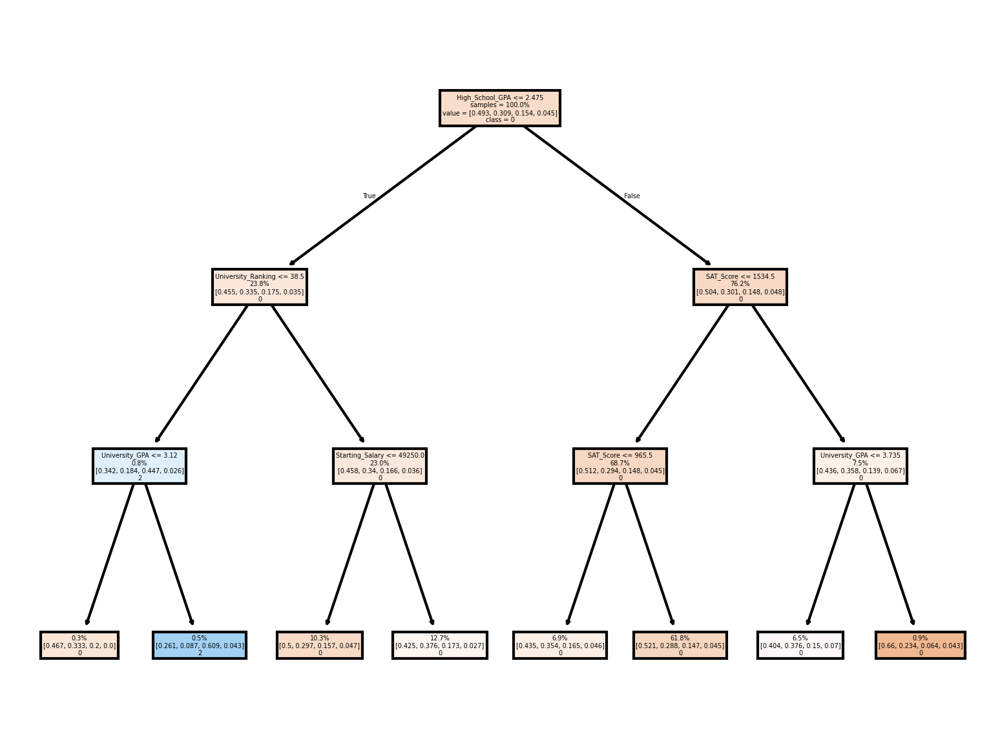

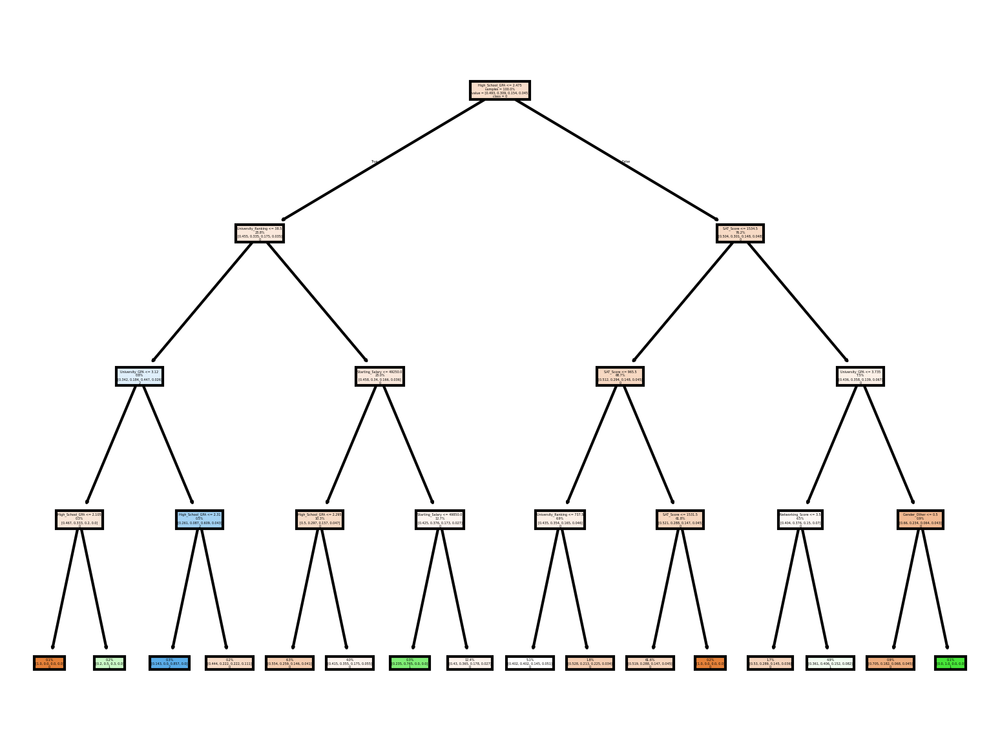

In [71]:
current_job_level_vals = ['0', '1', '2', '3']

map = {
    'Entry': 0,
    'Mid': 1,
    'Senior': 2,
    'Executive': 3
}

job_level_data = data

job_level_data['Current_Job_Level'] = job_level_data['Current_Job_Level'].map(map)

job_level_data_ml = pd.get_dummies(job_level_data)

for i in [2, 3, 4]:
    X = job_level_data_ml.drop('Current_Job_Level', axis=1)
    y = job_level_data_ml['Current_Job_Level']
    clf = DecisionTreeClassifier(max_depth=i).fit(X, y)
    
    import matplotlib.pyplot as plt
    plt.figure(dpi=300)
    plot_tree(
        clf,
        feature_names=X.columns,
        class_names = current_job_level_vals,
        label="root",
        filled=True,
        impurity=False,
        proportion=True,
        rounded=False
    )

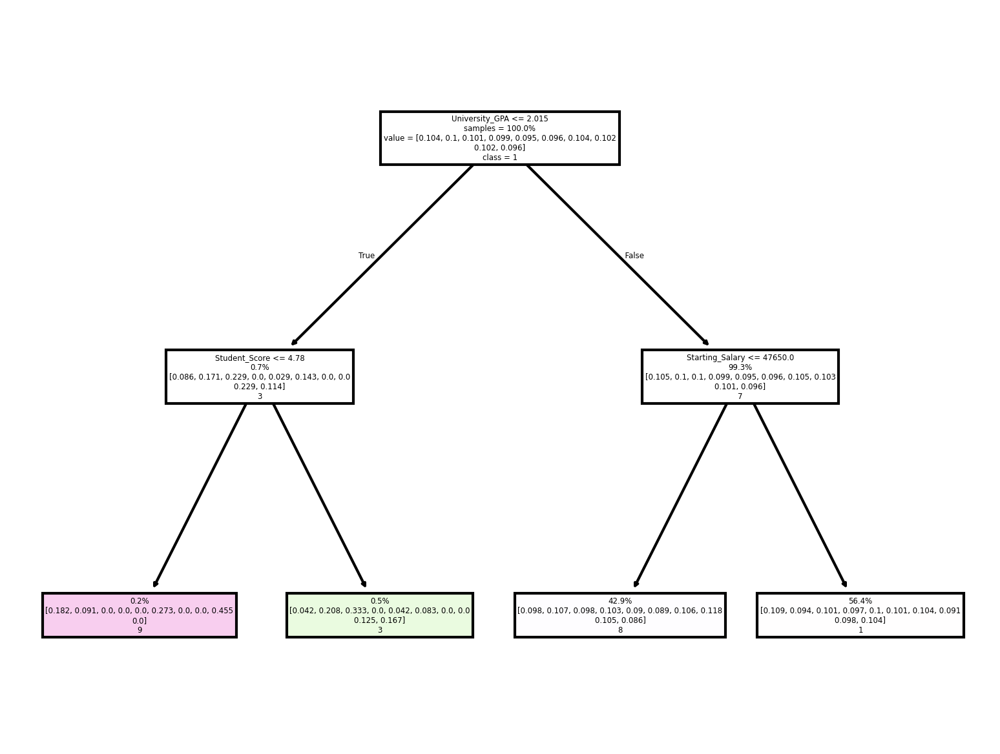

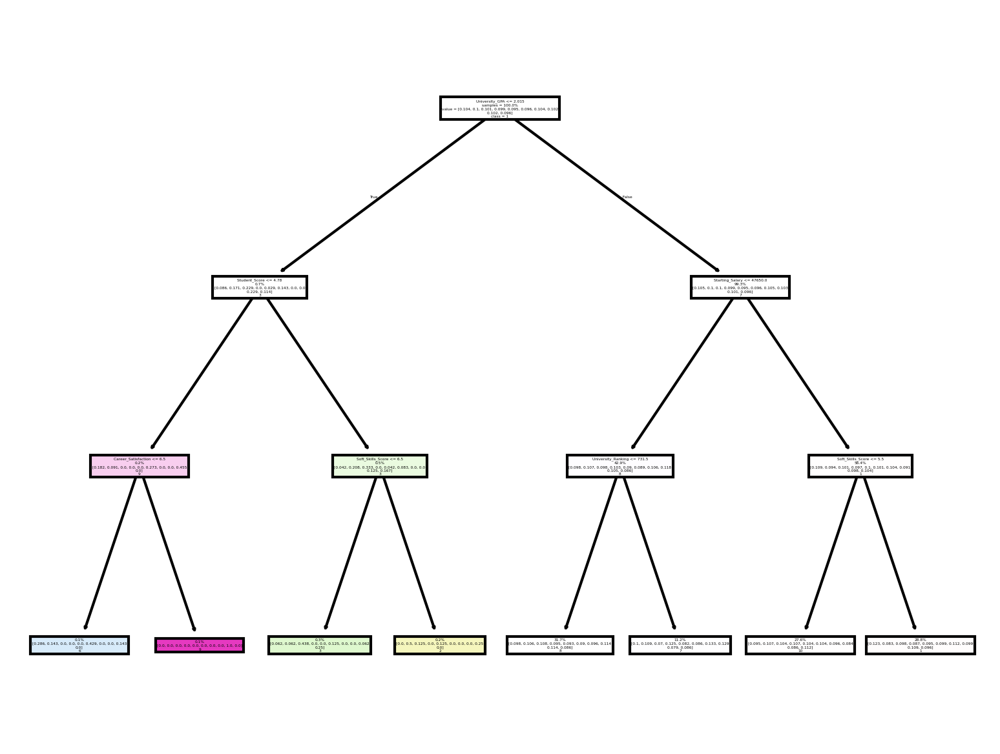

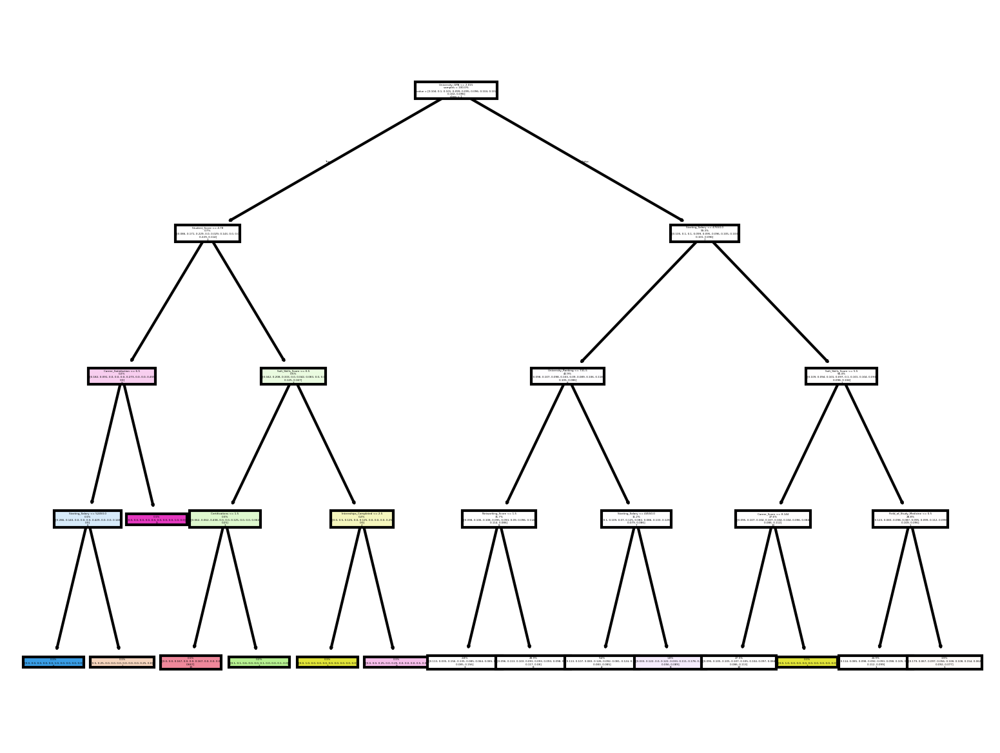

In [ ]:
work_life_balance_vals = ["1", '2', '3', '4', '5', '6', '7', '8', '9', '10']
for i in [2, 3, 4]:
    dec_tree("Work_Life_Balance", work_life_balance_vals, i)

## Implications and Limitations

*Replace this text with your analysis. Who might benefit from your analysis and who might be excluded or otherwise harmed by it? What about the data setting might have impacted your results? Explain at least 3 limitations of your analysis and how others should or shouldn't be advised to use your conclusions. You may remove the code cell below if you don't need it.*

CONCLUSIONS AND STUFF